# Projeto Final

## Integrantes do Grupo

1. **Nome(s):** Caio Alves, Fiorotti, Matheus Meier Schreiber, Vinicius Cole de Amorim

2. **Matrícula(s):** 2021100132, 2021101243, 2021100329

3. **E-mail(s) institucional(is):** caio.fiorotti@edu.ufes.br, matheus.schreiber@edu.ufes.br, vinicius.c.amorim@edu.ufes.br

4. **Curso(s):** Engenharia de Computação, Engenharia de Computação, Engenharia de Computação

## Vídeo

https://drive.google.com/file/d/12EW5_T6KFY85m31tm1gMMkhxrX2OrLaB/view?usp=sharing

In [ ]:
# !unzip data.zip

In [ ]:
import os
import pandas as pd
from sklearn.ensemble import RandomForestClassifier, BaggingClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.model_selection import train_test_split, GridSearchCV, StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, accuracy_score, roc_curve, auc
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import seaborn as sns
from scipy.stats import kurtosis, skew
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from collections import Counter
from random import randint as rand
from sklearn.preprocessing import StandardScaler, MinMaxScaler, label_binarize
from itertools import cycle
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from IPython.display import HTML
import matplotlib.pyplot as plt
import matplotlib.animation as animation

## Introdução

No ano de 2024, até o mês de agosto morreram 50.133 brasileiros por AVC no nosso país (SBAVC, 2025). Além disso, no período de 2008 a 2015, foram realizadas também no Brasil mais de 361 mil cirurgias de amputação de membros superiores e inferiores (PEIXOTO, Alberto Monteiro et al, 2017). A ausência/deficiência do membro nesses indivíduos resulta em alterações na biomecânica para compensar essa falta (WILLIAMS et al., 2016). Sendo assim, próteses e órteses desempenham papel fundamental na reabilitação  de pessoas que sofreram desses males (HAGBERG, 2008). Nos últimos anos, o avanço tecnológico permitiu a criação de dispositivos como esses capazes de ajustar o funcionamento ao paciente individual e realizam o movimento per ele (BOGUE, 2011). Entretanto, a operação de tais dispositivos se torna complexa devido aos diferentes modos de funcionamento e ao número de comandos que o usuário deve enviar para funcionar corretamente (VALLE et al., 2021). Ademais, a maioria dos dispositivos desenvolvidos até então possuem apenas sensores que detectam a cinética e/ou cinemática do movimento embarcados (ULHOA, 2023), portanto as intenções de movimento do usuário não são consideradas, resultando em um controle não volitivo (FLEMING, 2021).

Atualmente, a maioria desses dispositivos robóticos podem ser divididos em três categorias: passivos, semi-ativos e ativos. Os dispositivos passivos são puramente mecânicos, enquanto os semi-ativos usam microprocessadores embarcados para fazer a leitura de sensores não bioeletrônicos com o objetivo de modular a impedância das juntas. Já os dispositivos ativos utilizam os microcontroladores para proporcionar energia para o movimento do usuário com o auxílio de atuadores (motores nas juntas), a fim de compensar a falta de potência resultante da perda da musculatura do membro prejudicado (AHKAMI, 2023).

Para considerar as intenções de movimento do usuário no controle (volitivo) de próteses/órteses ativas e semi-ativas, sinais biológicos podem ser introduzidos no sistema mecatrônico, como o sinal mioelétrico (EMG), que representa um sinal biológico traduzido em um sinal elétrico que varia durante a mudança da atividade muscular (MCMANUS et al., 2020). Os sinais EMG podem ser captados de forma não invasiva, utilizando eletrodos colocados na superfície da pele (sEMG), ou de maneira invasiva, através de eletrodos implantados cirurgicamente (iEMG). A menos que o acidente tenha causado lesões nervosas severas, os comandos motores dos músculos ainda podem ser gerados pelo paciente, mesmo que esses comandos agora não estejam mais movendo os músculos da articulação.

Entretanto, interpretar o sinal EMG e traduzi-lo em movimento é uma tarefa não trivial, já que a composição dos movimentos dos membros humanos envolve o trabalho de vários músculos do corpo, e o valor do sinal em si é, por muitas vezes, impreciso e variável ao longo do tempo (PARKER et al., 2019). Para esse tipo de situação, é válido utilizar algoritmos de machine learning para traduzir esses sinais, uma vez que tais algoritmos são eficazes em identificar padrões complexos em grandes volumes de dados (GOODFELLOW et al., 2016). Este projeto visa explorar a capacidade de classificação de algoritmos de machine learning no contexto de controle de dispositivos de reabilitação robótica, mais especificamente, órteses de membro superior, com o objetivo de aprimorar a precisão e a usabilidade desses dispositivos para pacientes debilitados (ZHANG et al., 2022).

## Definição do Problema

Este projeto visa explorar o **controle volitivo de órteses robóticas** por meio da utilização de sinais biológicos, especificamente os **sinais mioelétricos** — que são os sinais elétricos gerados pela atividade muscular. A proposta é empregar **algoritmos de machine learning** para classificar a intenção de movimento do usuário com base na leitura desses sinais.

Os movimentos analisados incluem:

- **Flexão/Extensão do cotovelo**
- **Pronação/Supinação do antebraço**
- **Abertura/Fechamento da mão**

A classificação gerada pelo modelo pode ser utilizada para acionar um **controlador do dispositivo robótico**, que executaria o movimento identificado. Para o treinamento e a validação do modelo, foram utilizados dados rotulados, nos quais a ação realizada é previamente conhecida. Esses dados serão descritos na seção seguinte.


## Descrição do Conjunto de Dados

### Dados de treino



Os dados de treino são um conjunto de arquivos csv para cada indivíduo, todos com o mesmo cabeçalho (`ch1;ch2;ch3;ch4;ch5;ch6`) onde ch1 é o sinal do músculo da flexão de cotovelo, ch2 é o sinal do músculo da extensão de cotovelo, ch3, ch4, ch5 e ch6 são os sinais responsáveis pela pronação/supinação de pulso e abertura/fechamento de mão (músculos do antebraço, descritos mais a frente na seção de metodologia). O detalhamento da gravação de cada arquivo foi feito como segue:
- `flexion.csv`: 5 segundos com o braço totalmente relaxado, 5 segundos de flexão de cotovelo, 5 segundos com o braço totalmente relaxado, 5 segundos de flexão de cotovelo, 5 segundos com o braço totalmente relaxado, 5 segundos de flexão de cotovelo, 5 segundos com o braço totalmente relaxado, 5 segundos de flexão de cotovelo, 5 segundos com o braço totalmente relaxado.
- `extension.csv`: 5 segundos com o braço totalmente relaxado, 5 segundos de extensão de cotovelo, 5 segundos com o braço totalmente relaxado, 5 segundos de extensão de cotovelo, 5 segundos com o braço totalmente relaxado, 5 segundos de extensão de cotovelo, 5 segundos com o braço totalmente relaxado, 5 segundos de extensão de cotovelo, 5 segundos com o braço totalmente relaxado.
- `pronation.csv`: 5 segundos com o braço totalmente relaxado, 5 segundos de pronação de pulso, 5 segundos com o braço totalmente relaxado, 5 segundos de pronação de pulso, 5 segundos com o braço totalmente relaxado, 5 segundos de pronação de pulso, 5 segundos com o braço totalmente relaxado, 5 segundos de pronação de pulso, 5 segundos com o braço totalmente relaxado.
- `supination.csv`: 5 segundos com o braço totalmente relaxado, 5 segundos de supinação do pulso, 5 segundos com o braço totalmente relaxado, 5 segundos de supinação de pulso, 5 segundos com o braço totalmente relaxado, 5 segundos de supinação de pulso, 5 segundos com o braço totalmente relaxado, 5 segundos de supinação de pulso, 5 segundos com o braço totalmente relaxado.
- `open.csv`: 5 segundos com o braço totalmente relaxado, 5 segundos de abertura da mão, 5 segundos com o braço totalmente relaxado, 5 segundos de abertura da mão de pulso, 5 segundos com o braço totalmente relaxado, 5 segundos de abertura da mão, 5 segundos com o braço totalmente relaxado, 5 segundos de abertura da mão, 5 segundos com o braço totalmente relaxado.
- `close.csv`: 5 segundos com o braço totalmente relaxado, 5 segundos de fechamento da mão, 5 segundos com o braço totalmente relaxado, 5 segundos de fechamento da mão de pulso, 5 segundos com o braço totalmente relaxado, 5 segundos de fechamento da mão, 5 segundos com o braço totalmente relaxado, 5 segundos de fechamento da mão, 5 segundos com o braço totalmente relaxado.

Na Figura 1 é possível visualizar os sinais dos 6 canais gravados para o arquivo `flexiopn.csv`.

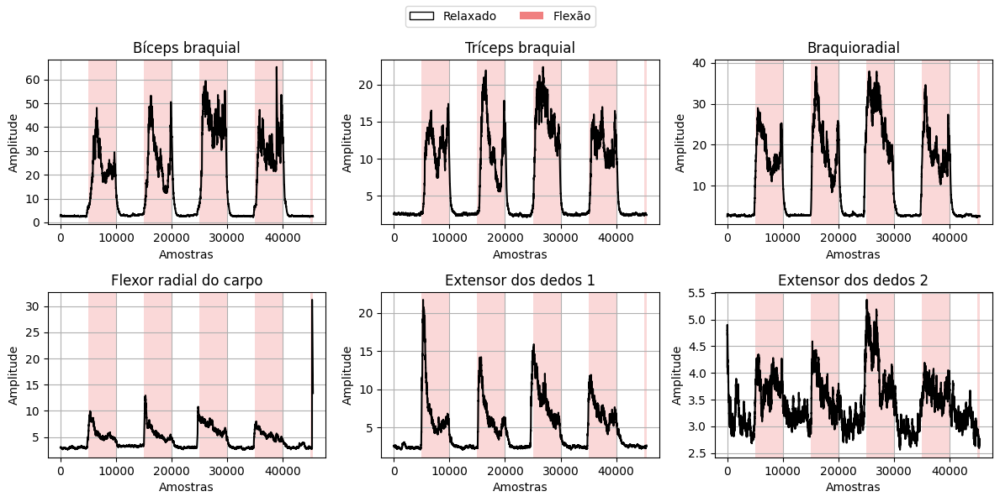

In [ ]:
#@title Figura 1 - Sinais dos 6 canais durante a gravação do arquivo `flexion.csv`
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import matplotlib.patches as mpatches  # Para criar legendas personalizadas

# Ler o CSV corretamente
file_name = "./data/3/flexion.csv"

df = pd.read_csv(file_name, delimiter=";")  # Definir o delimitador correto

# Criar a figura com subplots organizados em 2 linhas e 3 colunas
fig, axes = plt.subplots(2, 3, figsize=(12, 6))

# Títulos das colunas
titles = ["Bíceps braquial", "Tríceps braquial", "Braquioradial", "Flexor radial do carpo", "Extensor dos dedos 1", "Extensor dos dedos 2"]

# Número total de amostras
num_samples = len(df)

# Definir o tamanho das janelas de relaxamento/flexão
step = 5000

# Loop para iterar sobre as colunas e plotar nos subplots
for i, column in enumerate(df.columns):
    row = i // 3  # Linha do subplot (0 ou 1)
    col = i % 3   # Coluna do subplot (0, 1 ou 2)

    ax = axes[row, col]
    ax.plot(df[column], label=column, color='black')  # Sinal em preto
    ax.set_title(titles[i])
    ax.set_ylabel("Amplitude")
    ax.set_xlabel("Amostras")
    ax.grid(True)

    # Adicionar faixas alternadas de relaxado (branco) e flexão (vermelho claro)
    for j in range(0, num_samples, step):
        if (j // step) % 2 == 0:
            ax.axvspan(j, min(j + step, num_samples), facecolor='white', alpha=0.3)  # Branco para Relaxado
        else:
            ax.axvspan(j, min(j + step, num_samples), facecolor='lightcoral', alpha=0.3)  # Cor vermelha para Flexão

# Criar patches para legenda (corrigido o warning)
relaxado_patch = mpatches.Patch(facecolor='white', edgecolor='black', label='Relaxado', linewidth=1)
flexionado_patch = mpatches.Patch(facecolor='lightcoral', label='Flexão')

# Adicionar legenda ao gráfico principal
fig.legend(handles=[relaxado_patch, flexionado_patch], loc='upper center', ncol=2, fontsize=10, frameon=True)

# Ajusta o layout para evitar sobreposição
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Deixa espaço para a legenda no topo
plt.show()

### Dados de teste

O dado de teste é um arquivo csv para cada indivíduo, todos com o mesmo cabeçalho (`ch1,ch2,ch3,ch4.ch4,ch5,ch6`). Sua composição é a seguinte:
- `test.csv`: 5 segundos com o braço totalmente relaxado, 5 segundos de flexão de cotovelo, 5 segundos com o braço totalmente relaxado, 5 segundo de extensão de cotovelo, 5 segundos com o braço totalmente relaxado, 5 segundos de pronação do pulso, 5 segundos com o braço totalmente relaxado, 5 segundos de supinação do pulso, 5 segundos com o braço totalmente relaxado, 5 segundos de abertura de mão, 5 segundos com o braço totalmente relaxado e 5 segundos de fechamento de mão.

É possível visualizar na Figura 2 os siais dos 6 canais gerados durante a gravação do arquivo de teste.

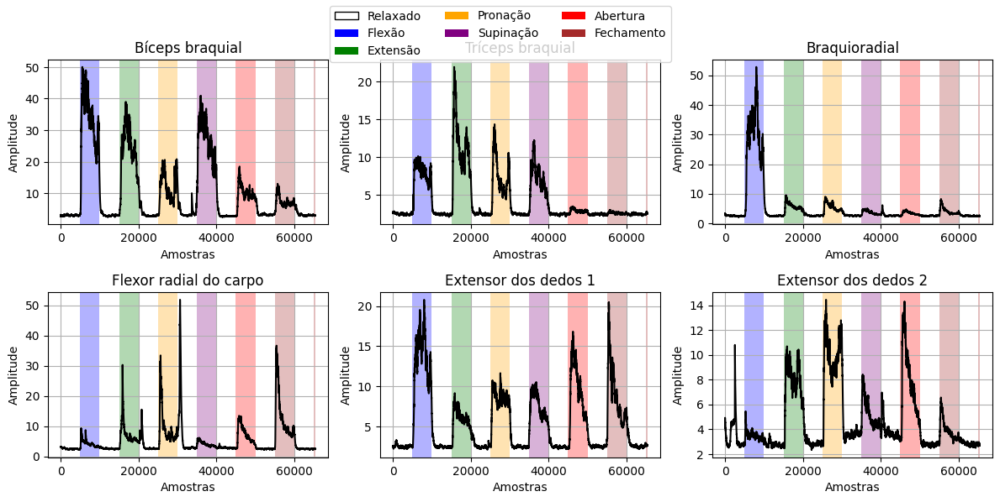

In [ ]:
#@title Figura 2 - Sinais dos 6 canais durante a gravação do arquivo `test.csv`
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import matplotlib.patches as mpatches  # Para criar legendas personalizadas

# Ler o CSV corretamente
file_name = "./data/2/test.csv"

df = pd.read_csv(file_name, delimiter=";")  # Definir o delimitador correto

# Criar a figura com subplots organizados em 2 linhas e 3 colunas
fig, axes = plt.subplots(2, 3, figsize=(12, 6))

# Títulos das colunas e cores correspondentes
titles = ["Flexão", "Extensão", "Pronação", "Supinação", "Abertura", "Fechamento"]
chanels = ["Bíceps braquial", "Tríceps braquial", "Braquioradial", "Flexor radial do carpo", "Extensor dos dedos 1", "Extensor dos dedos 2"]
colors = ['blue', 'green', 'orange', 'purple', 'red', 'brown']  # Cores diferentes para cada movimento
colors_index = -1
inc = False

# Número total de amostras
num_samples = len(df)

# Definir o tamanho das janelas de relaxamento/movimento
step = 5000

# Loop para iterar sobre as colunas e plotar nos subplots
for i, column in enumerate(df.columns):
    row = i // 3  # Linha do subplot (0 ou 1)
    col = i % 3   # Coluna do subplot (0, 1 ou 2)

    ax = axes[row, col]
    ax.plot(df[column], label=column, color='black')  # Sinal com a cor correspondente
    ax.set_title(chanels[i])
    ax.set_ylabel("Amplitude")
    ax.set_xlabel("Amostras")
    ax.grid(True)

    # Adicionar faixas alternadas de relaxado (branco) e movimento (cor correspondente)
    for j in range(0, num_samples, step):
        if (j // step) % 2 == 0:
            ax.axvspan(j, min(j + step, num_samples), facecolor='white', alpha=0.3)  # Branco para Relaxado
            inc = True
        else:
            if inc and colors_index < len(titles) - 1:
                colors_index += 1
                inc = False
            ax.axvspan(j, min(j + step, num_samples), facecolor=colors[colors_index], alpha=0.3)  # Cor do movimento

    inc = False
    colors_index = -1


# Criar patches para legenda
relaxado_patch = mpatches.Patch(facecolor='white', edgecolor='black', label='Relaxado', linewidth=1)
movimento_patches = [mpatches.Patch(facecolor=colors[i], label=titles[i]) for i in range(len(titles))]

# Adicionar legenda ao gráfico principal
fig.legend(handles=[relaxado_patch] + movimento_patches, loc='upper center', ncol=3, fontsize=10, frameon=True)

# Ajusta o layout para evitar sobreposição
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Deixa espaço para a legenda no topo
plt.show()

## Metodologia

### Coleta dos Dados

Os movimento de flexão/extensão, pronação/supinação e abertura/fechamento foram gravados considerando a **máxima contração voluntária** do indivíduo.

Coletou-se os dados de 6 indivíduos saudáveis usando o microcontrolador _MyoSym_, desenvolvido pela Symbios Tecnologias Assistivas (UFES), e transferidos para o computador para serem salvos nos arquivos csv a uma taxa de **1000Hz**.

A relação entre canal e músuculo capturado foi:
> **ch1:** _bíceps braquial_ <br>
> **ch2:** _tríceps braquial_ <br>
> **ch3:** _braquioradial_ <br>
> **ch4:** _flexor radial do carpo_<br>
> **ch5:** _extensor dos dedos (porção próxima ao cotovelo)_<br>
> **ch6:** _extensor dos dedos (porção próxima ao punho)_<br>

A porção do braço que corresponde a cada um desses músculos pode ser visualizada na Figura 3.

Figra 3 - Anatomia superficial do braço e antebraço (GILROY)

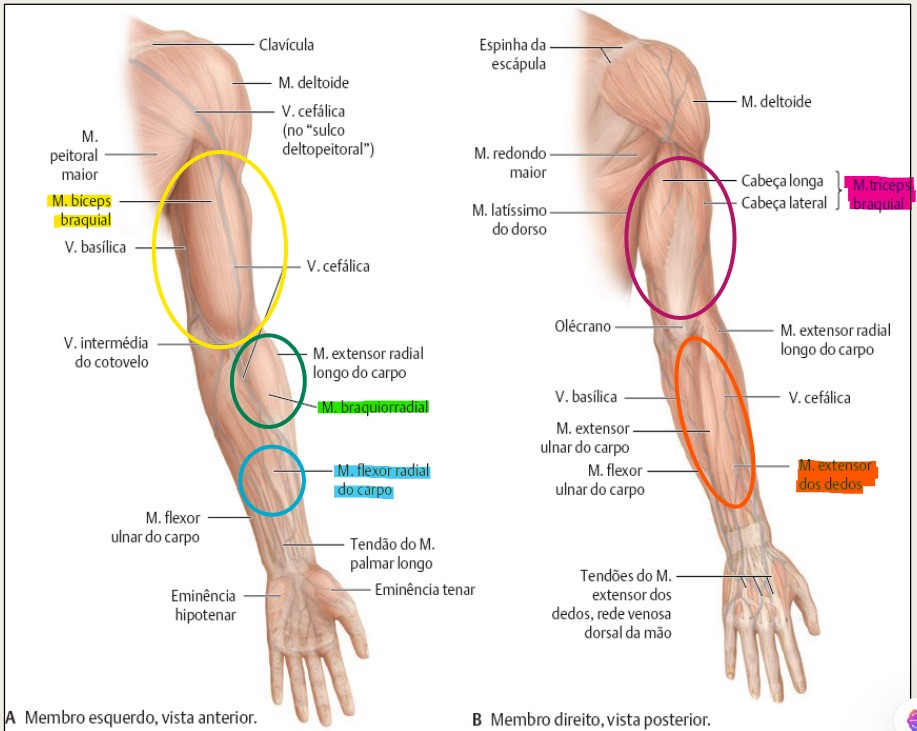

Abaixo observa-se na imagem à esquerda e ao centro, a posição dos sensores no membro superior do indivíduo. À direita, tem-se a visão do microcontrolador MyoSym utilizado para a coleta.

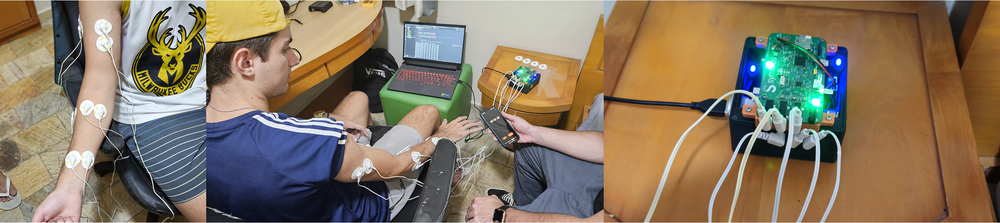

As informações sobre os indivíduos que participaram da coleta estão descritas na tabela a seguir:

<table>
<tr>
  <th>Identificação</th>
  <th>Sexo</th>
  <th>Idade</th>
  <th>Peso</th>
  <th>Altura</th>
  <th>Mão dominante</th>
<tr>
<tr>
  <td>Indivíduo 1</td>
  <td>Masculino</td>
  <td>22 anos</td>
  <td>82 kg</td>
  <td>1,75 m</td>
  <td>Direita</td>
</tr>
<tr>
  <td>Indivíduo 2</td>
  <td>Masculino</td>
  <td>21 anos</td>
  <td>75 kg</td>
  <td>1,80 m</td>
  <td>Direita</td>
</tr>
<tr>
  <td>Indivíduo 3</td>
  <td>Masculino</td>
  <td>23 anos</td>
  <td>70 kg</td>
  <td>1,81 m</td>
  <td>Direita</td>
</tr>
<tr>
  <td>Indivíduo 4</td>
  <td>Feminino</td>
  <td>50 anos</td>
  <td>65 kg</td>
  <td>1,65 m</td>
  <td>Direita</td>
</tr>
<tr>
  <td>Indivíduo 5</td>
  <td>Masculino</td>
  <td>53 anos</td>
  <td>70 kg</td>
  <td>1,71 m</td>
  <td>Direita</td>
</tr>
<tr>
  <td>Indivíduo 6</td>
  <td>Masculino</td>
  <td>22 anos</td>
  <td>80 kg</td>
  <td>1,75 m</td>
  <td>Direita</td>
</tr>
</table>

### Treinamento

Primeiramente, separou-se os sinais em janelas de 250 milisegundos. Como os dados foram coletados a 1000Hz, cada janela corresponde a 250 amostras de cada canal. A Figura 4 ilustra tal situação.

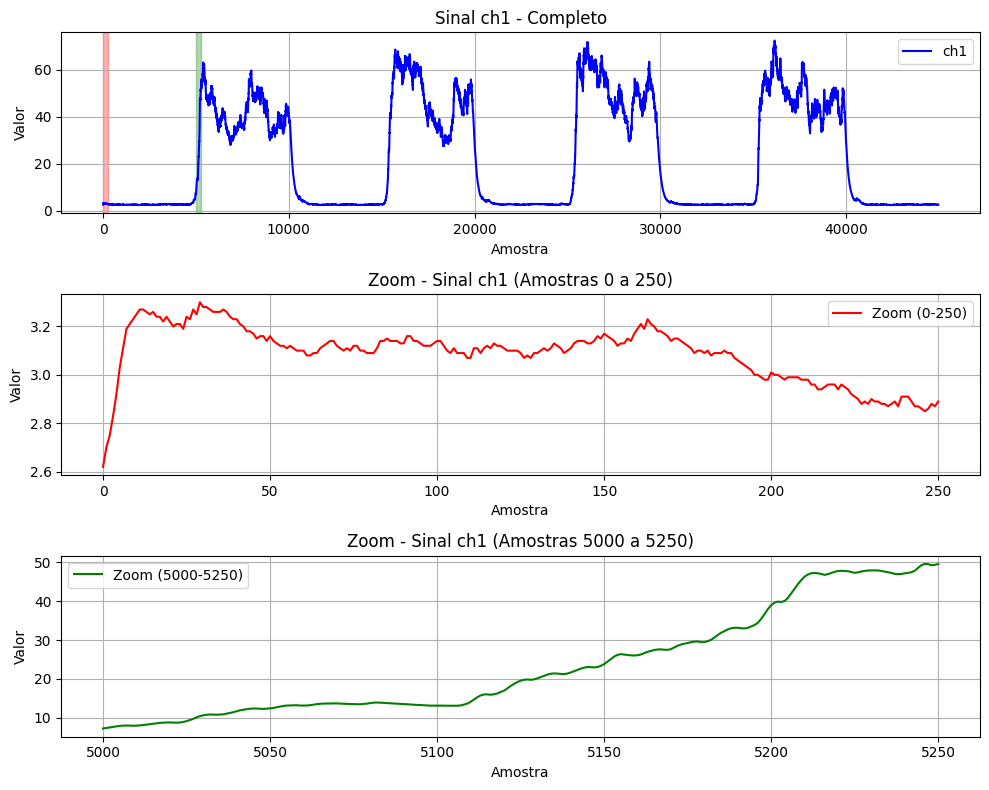

In [ ]:
#@title Figura 4 - Ilustração de duas janelas (retângulos em vermelho e verde) do sinal de um canal (em azul)
import pandas as pd
import matplotlib.pyplot as plt

file_path = "./data/2/flexion.csv"

# Recarregar o arquivo com o separador correto
df = pd.read_csv(file_path, sep=";")

# Extrair a coluna ch1
ch1_data = df["ch1"]

# Exibir as primeiras linhas da coluna ch1
ch1_data.head()


# Criar a figura e os subplots
fig, ax = plt.subplots(3, 1, figsize=(10, 8))

# Plotar todos os dados de ch1
ax[0].plot(ch1_data, label="ch1", color="blue")
ax[0].set_title("Sinal ch1 - Completo")
ax[0].set_xlabel("Amostra")
ax[0].set_ylabel("Valor")
ax[0].legend()
ax[0].grid()

# Destacar a região de zoom
ax[0].axvspan(0, 250, color="red", alpha=0.3)
ax[0].axvspan(5000, 5250, color="green", alpha=0.3)

# Plotar apenas os dados entre as amostras 0 e 250
ax[1].plot(ch1_data[:251], label="Zoom (0-250)", color="red")
ax[1].set_title("Zoom - Sinal ch1 (Amostras 0 a 250)")
ax[1].set_xlabel("Amostra")
ax[1].set_ylabel("Valor")
ax[1].legend()
ax[1].grid()

# Plotar apenas os dados entre as amostras 5000 e 5250
ax[2].plot(ch1_data[5000:5251], label="Zoom (5000-5250)", color="green")
ax[2].set_title("Zoom - Sinal ch1 (Amostras 5000 a 5250)")
ax[2].set_xlabel("Amostra")
ax[2].set_ylabel("Valor")
ax[2].legend()
ax[2].grid()

# Ajustar layout e mostrar o gráfico
plt.tight_layout()
plt.show()


Como os dados foram coletados por conta própria, sabe-se o label (qual movimento estava sendo executado no momento) de cada janela, dependendo do arquivo analisado. No caso dos arquivos de treino, a cada 5000 amostras temos uma mudança do estado relaxo para o movimento (esse dependendo do arquivo em questão), e depois de mais 5000 amostras uma mudança do movimento em questão para o estado relaxado, alternando assim até a amostra de número 45000 (aproximadamente). Sendo assim, utilizou-se desse fato para treinar os algoritmos de classificação com as features da janela sendo a entrada do modelo, e o label do movimento executado no momento, a saída.

In [ ]:
def prepare_train_data(file_path, label):
    """
    Loads a CSV file and prepares the data for training a model.

    Args:
        file_path (str): Path to the CSV file.
        label (str): Class label.

    Returns:
        tuple: Tuple containing a DataFrame with the features of the window and a list with the labels.
    """
    df = pd.read_csv(file_path, delimiter=";")

    # # Padronize data
    # standard_scaler = StandardScaler()
    # df = pd.DataFrame(standard_scaler.fit_transform(df), columns=df.columns)

    # # Normalize data
    # min_max_scaler = MinMaxScaler()
    # df = pd.DataFrame(min_max_scaler.fit_transform(df), columns=df.columns)

    window_size = 250
    step_size = window_size

    windows_features = []
    windows_features_labels = []
    sample_count = 0
    for i in range(0, len(df), step_size):
        window = df.iloc[i:i+window_size]

        if len(window) < window_size:
            # Ignore incomplete windows
            continue

        windows_features.append(extract_features(window))

        if sample_count >= 0 and sample_count < 5000:
            windows_features_labels.append("rest")
        elif sample_count >= 5000 and sample_count < 10000:
            windows_features_labels.append(label)
        elif sample_count >= 10000 and sample_count < 15000:
            windows_features_labels.append("rest")
        elif sample_count >= 15000 and sample_count < 20000:
            windows_features_labels.append(label)
        elif sample_count >= 20000 and sample_count < 25000:
            windows_features_labels.append("rest")
        elif sample_count >= 25000 and sample_count < 30000:
            windows_features_labels.append(label)
        elif sample_count >= 30000 and sample_count < 35000:
            windows_features_labels.append("rest")
        elif sample_count >= 35000 and sample_count < 40000:
            windows_features_labels.append(label)
        else:
            windows_features_labels.append("rest")

        sample_count += step_size

    return windows_features, windows_features_labels

Treinou-se os modelos tanto de forma individual (com os dados de apenas um dos individuos) quanto de forma geral (com os dados de todos os indivíduos)

### Teste

Do mesmo modo, preparou-se os dados para o teste. Lembrando que o teste foi feito com o arquivo gravado especificamente para esse fim. No caso dos modelos individuais, testou-se com o arquivo de teste do individuo em específico. Já no caso do modelo geral, testou-se o modelo com o arquivo de teste de todos os indivíduos.

In [ ]:
def prepare_test_data(file_path):
    """
    Loads a CSV file and prepares the data for testing a model.

    Args:
        file_path (str): Path to the CSV file.

    Returns:
        tuple: Tuple containing a DataFrame with the features of the window and a list with the labels.
    """
    df = pd.read_csv(file_path, delimiter=";")

    # # Padronize data
    # standard_scaler = StandardScaler()
    # df = pd.DataFrame(standard_scaler.fit_transform(df), columns=df.columns)

    # # Normalize data
    # min_max_scaler = MinMaxScaler()
    # df = pd.DataFrame(min_max_scaler.fit_transform(df), columns=df.columns)

    window_size = 250
    step_size = window_size

    windows_features = []
    windows_features_labels = []
    sample_count = 0
    for i in range(0, len(df), step_size):
        window = df.iloc[i:i+window_size]

        if len(window) < window_size:
            # Ignore incomplete windows
            continue

        windows_features.append(extract_features(window))

        if sample_count >= 0 and sample_count < 5000:
            windows_features_labels.append("rest")
        elif sample_count >= 5000 and sample_count < 10000:
            windows_features_labels.append("flexion")
        elif sample_count >= 10000 and sample_count < 15000:
            windows_features_labels.append("rest")
        elif sample_count >= 15000 and sample_count < 20000:
            windows_features_labels.append("extension")
        elif sample_count >= 20000 and sample_count < 25000:
            windows_features_labels.append("rest")
        elif sample_count >= 25000 and sample_count < 30000:
            windows_features_labels.append("pronation")
        elif sample_count >= 30000 and sample_count < 35000:
            windows_features_labels.append("rest")
        elif sample_count >= 35000 and sample_count < 40000:
            windows_features_labels.append("supination")
        elif sample_count >= 40000 and sample_count < 45000:
            windows_features_labels.append("rest")
        elif sample_count >= 45000 and sample_count < 50000:
            windows_features_labels.append("open")
        elif sample_count >= 50000 and sample_count < 55000:
            windows_features_labels.append("rest")
        elif sample_count >= 55000 and sample_count < 60000:
            windows_features_labels.append("close")
        else:
            windows_features_labels.append("rest")

        sample_count += step_size

    return windows_features, windows_features_labels

### Padronização e Normalização

A padronização dos sinais utilizando `StandardScaler` e a normalização com `MinMaxScaler` foram testadas, mas não adotadas na versão final do projeto devido à queda no desempenho dos algoritmos de classificação. Isso ocorreu porque, ao transformar os dados, ambas as técnicas alteraram a distribuição original dos sinais mioelétricos, possivelmente removendo informações relevantes para a diferenciação dos movimentos. Além disso, como os sinais mioelétricos possuem características intrinsecamente variáveis entre diferentes indivíduos e contextos de captação, a aplicação dessas transformações pode ter reduzido a separabilidade das classes, dificultando a aprendizagem dos modelos. Como resultado, os classificadores apresentaram uma pior performance, justificando a escolha de manter os dados em sua escala original.

### Extração de Features

Como já pode ser percebido nas seções anteriormente, para otimizar o processamento e reduzir o grande volume de dados, foram extraídas características (features) significativas de cada janela de dados. Essas features, calculadas para cada canal, incluem:

- **Média**: Representa o valor médio dos sinais na janela, fornecendo uma medida central.
- **Desvio Padrão**: Indica a variabilidade dos dados em relação à média, permitindo entender a dispersão dos sinais.
- **Amplitude Máxima**: Refere-se ao maior valor observado na janela, evidenciando a intensidade máxima do sinal.
- **Energia**: Calculada como a soma dos quadrados dos dados, ${\sum \text{dados}^2}$, fornece uma medida da potência do sinal durante a janela.
- **Assimetria**: Avalia a simetria da distribuição dos dados, indicando se a distribuição é inclinada para a esquerda ou para a direita.
- **Curtose**: Mede a "altura" e a "largura" da distribuição, informando sobre a presença de valores extremos (outliers) em comparação com uma distribuição normal.

Essas características extraídas são fundamentais para a subsequente etapa de classificação, permitindo que os algoritmos de machine learning reconheçam padrões e intenções motoras de forma mais eficaz.


In [ ]:
def extract_features(window):
    """
    Extracts features from a DataFrame containing muscle signal windows.

    Args:
        window (pd.DataFrame): DataFrame contendo as janelas de sinais musculares.

    Returns:
        list: mean, std, amplitude, energy, skewness and kurtosis for each channel.
    """
    features = []
    for column in window.columns:
        data = window[column]
        features.extend([
            np.mean(data),
            np.std(data),
            np.max(data) - np.min(data),
            np.sum(data ** 2),
            skew(data),
            kurtosis(data)
        ])
    return features

### Modelos

Para a classificação da intenção de movimento, diversos algoritmos de machine learning foram testados, cada um com suas particularidades e potencialidades. Os modelos avaliados incluem:

- **KNN (K-Nearest Neighbors)**: Um algoritmo simples e intuitivo que classifica novos dados com base na similaridade com os k vizinhos mais próximos no espaço de características. É eficaz em datasets de pequeno a médio porte, embora possa ser sensível ao ruído e à dimensionalidade dos dados.

- **Árvore de Decisão**: Um modelo que utiliza uma estrutura em forma de árvore para tomar decisões baseadas em perguntas sequenciais sobre os dados. É fácil de interpretar e visualizar, mas pode ser propenso ao overfitting se não for devidamente podado.

- **Random Forest**: Uma extensão das árvores de decisão que cria um conjunto (ensemble) de árvores, melhorando a precisão e reduzindo a variabilidade. Cada árvore é treinada em uma amostra aleatória do conjunto de dados, e a decisão final é feita pela média das previsões das árvores individuais.

- **Bagging (Base: Árvore)**: O método de "Bootstrap Aggregating" combina múltiplas instâncias de um algoritmo de aprendizado (neste caso, árvores de decisão) para criar um modelo mais robusto e menos suscetível ao overfitting. Ao treinar cada árvore em um subconjunto aleatório dos dados, bagging melhora a estabilidade e a precisão das previsões.

- **AdaBoost (Adaptive Boosting)**: Um algoritmo de boosting que ajusta o peso dos classificadores anteriores para melhorar a classificação de exemplos difíceis. Ele combina múltiplos classificadores fracos em um forte, aumentando progressivamente a precisão do modelo.

Esses modelos foram escolhidos com base nas aulas e foram avaliados quanto à sua capacidade de reconhecer padrões nos sinais mioelétricos, proporcionando insights sobre a intenção de movimento dos usuários.


In [ ]:
data_dir = "./data"

models = {
    "KNN": KNeighborsClassifier(n_neighbors=5, weights="uniform", metric="euclidean"),
    "Decision Tree": DecisionTreeClassifier(max_depth=None, criterion="gini"),
    "Random Forest": RandomForestClassifier(n_estimators=100, max_depth=None, criterion="gini"),
    "Bagging (Base: Árvore)": BaggingClassifier(estimator=DecisionTreeClassifier(), n_estimators=50, random_state=42),
    "AdaBoost": AdaBoostClassifier(n_estimators=50, random_state=42),
}

### Validação Cruzada (escolha dos hiperparâmetros)

Para a seleção otimizada dos hiperparâmetros, foi empregada a técnica de **GridSearch** da biblioteca `sklearn`, que permite testar automaticamente diferentes combinações de hiperparâmetros. Essa abordagem, aliada à validação cruzada, assegura a identificação dos melhores parâmetros para cada modelo antes do treinamento final, aumentando assim a robustez e a precisão das previsões.

Considerando a natureza sequencial dos dados, uma vez que os sinais mioelétricos são coletados ao longo do tempo, a validação cruzada k-fold aleatória pode não ser a abordagem mais adequada. Em vez disso, optou-se pelo método **Stratified K-Fold**. Essa estratégia garante que a distribuição das classes seja mantida em cada fold, permitindo uma avaliação mais precisa da performance do modelo e minimizando viéses que poderiam ocorrer devido a uma amostragem desbalanceada.

**O teste foi feito apenas com o modelo que obteve a melhor performance na validação.**


In [ ]:
param_grids = {
    "KNN": {
        "n_neighbors": [3, 5, 7, 9],
        "weights": ["uniform", "distance"],
        "metric": ["euclidean", "manhattan"]
    },
    "Decision Tree": {
        "max_depth": [5, 10, 15, None],
        "criterion": ["gini", "entropy"]
    },
    "Random Forest": {
        "n_estimators": [100, 200, 300],
        "max_depth": [10, 20, None],
        "criterion": ["gini", "entropy"]
    },
    "Bagging (Base: Árvore)": {
        "n_estimators": [10, 50, 100],
        "max_samples": [0.5, 0.7, 1.0]
    },
    "AdaBoost": {
        "n_estimators": [50, 100, 200],
        "learning_rate": [0.01, 0.1, 1]
    },
}

## Modelos individuais

Vamos começar analisando cada indivíduo **individualmente**.

In [ ]:
# Save individuals
individuals = {}
with open(f"{data_dir}/readme.txt", "r") as file:
    for line in file:
        number, name = line.strip().split(",")
        individuals[number] = name


# Train each individual separately
all_report = []
all_cm_figs = []
all_roc_figs = []
for individual_number, individual_name in individuals.items():
    print(f"\n\nProcessing individual: {individual_number}")

    flexion_windows_features, flexion_windows_features_labels = prepare_train_data(f"{data_dir}/{individual_number}/flexion.csv", "flexion")
    extension_windows_features, extension_windows_features_labels = prepare_train_data(f"{data_dir}/{individual_number}/extension.csv", "extension")
    pronation_windows_features, pronation_windows_features_labels = prepare_train_data(f"{data_dir}/{individual_number}/pronation.csv", "pronation")
    supination_windows_features, supination_windows_features_labels = prepare_train_data(f"{data_dir}/{individual_number}/supination.csv", "supination")
    open_windows_features, open_windows_features_labels = prepare_train_data(f"{data_dir}/{individual_number}/open.csv", "open")
    close_windows_features, close_windows_features_labels = prepare_train_data(f"{data_dir}/{individual_number}/close.csv", "close")

    X_train = flexion_windows_features + extension_windows_features + pronation_windows_features + supination_windows_features + open_windows_features + close_windows_features
    y_train = flexion_windows_features_labels + extension_windows_features_labels + pronation_windows_features_labels + supination_windows_features_labels + open_windows_features_labels + close_windows_features_labels

    X_test, y_test = prepare_test_data(f"{data_dir}/{individual_number}/test.csv")

    print("\nDistribution of classes in training:", Counter(y_train))
    print(f"Distribution of classes in the test: {Counter(y_test)}\n")

    # Cross validation
    best_models = {}
    kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    for name, model in models.items():
        print(f"Tuning hyperparameters for {name}...")
        grid_search = GridSearchCV(
            model, param_grids[name], cv=kf, scoring="accuracy", n_jobs=-1
        )
        grid_search.fit(X_train, y_train)
        best_models[name] = grid_search.best_estimator_
        print(f"Best params for {name}: {grid_search.best_params_}")
        print(f"Best cross-validation accuracy: {grid_search.best_score_}\n")


    # Find best model in test
    best_accuracy = -1
    best_model = None
    best_y_pred = None
    for name, model in best_models.items():
        y_pred = model.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)
        print(f"{name} - Test Accuracy: {accuracy}")
        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_model = model
            best_y_pred = y_pred

    print("\nBest model in test:")
    print(best_model)

    # Saving reports
    all_report.append(classification_report(y_test, best_y_pred, zero_division=0))

    # Saving confusion matrices
    cm = confusion_matrix(y_test, best_y_pred, labels=np.unique(y_test))
    cm_normalized = cm.astype('float') / cm.sum(axis=1, keepdims=True) * 100
    cm_df = pd.DataFrame(cm_normalized, index=np.unique(y_test), columns=np.unique(y_test))
    fig_cm, ax_cm = plt.subplots(figsize=(16, 12))
    sns.heatmap(
        cm_df,
        annot=True,
        fmt=".2f",
        cmap="Blues",
        linewidths=0.5,
        vmin=0, vmax=100,
        ax=ax_cm,
        annot_kws={"size": 16}
    )
    ax_cm.set_title("Normalized Confusion Matrix (%) for Individual " + individual_number, fontsize=22)
    ax_cm.set_xlabel("Predicted", fontsize=18)
    ax_cm.set_ylabel("Real", fontsize=18)
    ax_cm.tick_params(axis='both', which='major', labelsize=18)
    all_cm_figs.append(fig_cm)
    plt.close(fig_cm) # Close the figure to not be displayed now



Processing individual: 1

Distribution of classes in training: Counter({'rest': 585, 'flexion': 80, 'extension': 80, 'pronation': 80, 'supination': 80, 'open': 80, 'close': 80})
Distribution of classes in the test: Counter({'rest': 138, 'flexion': 20, 'extension': 20, 'pronation': 20, 'supination': 20, 'open': 20, 'close': 20})

Tuning hyperparameters for KNN...
Best params for KNN: {'metric': 'manhattan', 'n_neighbors': 9, 'weights': 'distance'}
Best cross-validation accuracy: 0.9380281690140844

Tuning hyperparameters for Decision Tree...
Best params for Decision Tree: {'criterion': 'gini', 'max_depth': 10}
Best cross-validation accuracy: 0.8948356807511738

Tuning hyperparameters for Random Forest...
Best params for Random Forest: {'criterion': 'gini', 'max_depth': None, 'n_estimators': 100}
Best cross-validation accuracy: 0.939906103286385

Tuning hyperparameters for Bagging (Base: Árvore)...
Best params for Bagging (Base: Árvore): {'max_samples': 0.5, 'n_estimators': 50}
Best cr

### Resultados

Para os modelos de cada indivíduo separadamente, temos:

`Report de classificação:`

In [ ]:
for i, report in enumerate(all_report):
    print(f"\n\nIndividual {i+1}:\n{report}")



Individual 1:
              precision    recall  f1-score   support

       close       0.93      0.65      0.76        20
   extension       0.83      0.25      0.38        20
     flexion       0.77      1.00      0.87        20
        open       0.87      1.00      0.93        20
   pronation       0.71      0.85      0.77        20
        rest       0.90      0.99      0.94       138
  supination       1.00      0.70      0.82        20

    accuracy                           0.87       258
   macro avg       0.86      0.78      0.78       258
weighted avg       0.88      0.87      0.86       258



Individual 2:
              precision    recall  f1-score   support

       close       0.91      1.00      0.95        20
   extension       0.69      0.90      0.78        20
     flexion       1.00      0.75      0.86        20
        open       1.00      0.30      0.46        20
   pronation       0.63      0.95      0.76        20
        rest       0.95      0.97      0.96   

`Matrizes de confusão`

In [ ]:
# Calculating the arrangement of figures according to the number of individuals
num_individuals = len(all_cm_figs)
rows = (num_individuals // 2) + (num_individuals % 2 > 0)

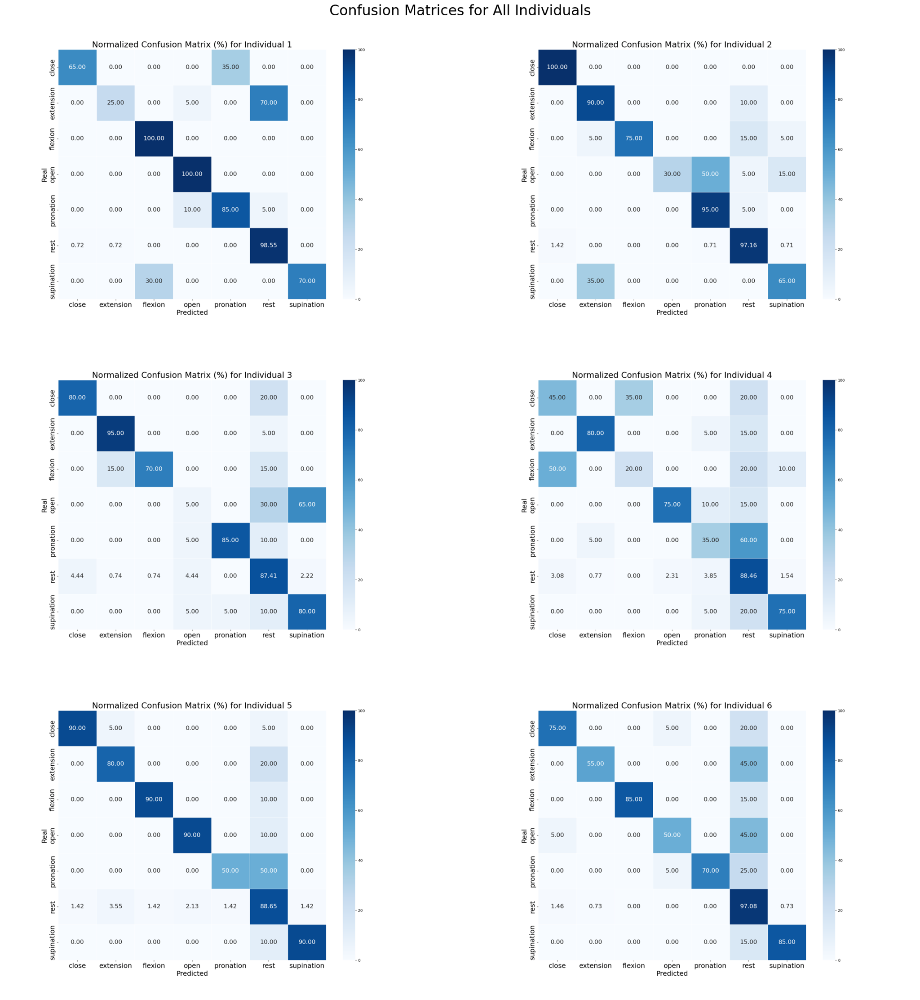

In [ ]:
# Plotting all confusion matrices in a single figure
fig_cm, axes_cm = plt.subplots(rows, 2, figsize=(24, 8 * rows))
axes_cm = np.array(axes_cm).flatten()

for i, fig in enumerate(all_cm_figs):
    fig.canvas.draw()
    img = np.array(fig.canvas.buffer_rgba())
    axes_cm[i].imshow(img)
    axes_cm[i].axis("off")

plt.suptitle("Confusion Matrices for All Individuals", fontsize=24)
plt.tight_layout()
plt.show()

## Modelo geral

Agora vamos fazer tudo que fizemos individualmente, mas utilizando os dados de todos os indivíduos juntos para formar apenas um modelo **geral**.

In [ ]:
flexion_windows_features, flexion_windows_features_labels = [], []
extension_windows_features, extension_windows_features_labels = [], []
pronation_windows_features, pronation_windows_features_labels = [], []
supination_windows_features, supination_windows_features_labels = [], []
open_windows_features, open_windows_features_labels = [], []
close_windows_features, close_windows_features_labels = [], []

# Put all data together
for folder in os.listdir(data_dir):
    if os.path.isdir(os.path.join(data_dir, folder)) and folder != ".ipynb_checkpoints":
        aux1, aux2 = prepare_train_data(f"{data_dir}/{folder}/flexion.csv", "flexion")
        flexion_windows_features += aux1
        flexion_windows_features_labels += aux2
        aux1, aux2 = prepare_train_data(f"{data_dir}/{folder}/extension.csv", "extension")
        extension_windows_features += aux1
        extension_windows_features_labels += aux2
        aux1, aux2 = prepare_train_data(f"{data_dir}/{folder}/pronation.csv", "pronation")
        pronation_windows_features += aux1
        pronation_windows_features_labels += aux2
        aux1, aux2 = prepare_train_data(f"{data_dir}/{folder}/supination.csv", "supination")
        supination_windows_features += aux1
        supination_windows_features_labels += aux2
        aux1, aux2 = prepare_train_data(f"{data_dir}/{folder}/open.csv", "open")
        open_windows_features += aux1
        open_windows_features_labels += aux2
        aux1, aux2 = prepare_train_data(f"{data_dir}/{folder}/close.csv", "close")
        close_windows_features += aux1
        close_windows_features_labels += aux2

X_train = flexion_windows_features + extension_windows_features + pronation_windows_features + supination_windows_features + open_windows_features + close_windows_features
y_train = flexion_windows_features_labels + extension_windows_features_labels + pronation_windows_features_labels + supination_windows_features_labels + open_windows_features_labels + close_windows_features_labels

print("\nDistribution of classes in training:", Counter(y_train))


# Train with all individuals together
# Cross validation
best_models = {}
kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
for name, model in models.items():
    print(f"\nTuning hyperparameters for {name}...")
    grid_search = GridSearchCV(
        model, param_grids[name], cv=kf, scoring="accuracy", n_jobs=-1
    )
    grid_search.fit(X_train, y_train)
    best_models[name] = grid_search.best_estimator_
    print(f"Best params for {name}: {grid_search.best_params_}")
    print(f"Best cross-validation accuracy: {grid_search.best_score_}\n")


# Test with each individual separately
all_report = []
all_cm_figs = []
global_cm = None
for individual_number, individual_name in individuals.items():
    print(f"\n\nTesting general model with individual: {individual_number}")
    X_test, y_test = prepare_test_data(f"{data_dir}/{individual_number}/test.csv")

    # Find best model in test
    best_accuracy = -1
    best_model = None
    best_y_pred = None
    for name, model in best_models.items():
        y_pred = model.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)
        print(f"{name} - Test Accuracy: {accuracy}")
        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_model = model
            best_y_pred = y_pred

    print("\nBest model in test:")
    print(best_model)

    # Saving reports
    all_report.append(classification_report(y_test, best_y_pred, zero_division=0, output_dict=True))

    # Saving the confusion matrices
    cm = confusion_matrix(y_test, best_y_pred, labels=np.unique(y_test))
    cm_normalized = cm.astype('float') / cm.sum(axis=1, keepdims=True) * 100
    cm_df = pd.DataFrame(cm_normalized, index=np.unique(y_test), columns=np.unique(y_test))
    fig_cm, ax_cm = plt.subplots(figsize=(16, 12))
    sns.heatmap(
        cm_df,
        annot=True,
        fmt=".2f",
        cmap="Blues",
        linewidths=0.5,
        vmin=0, vmax=100,
        ax=ax_cm,
        annot_kws={"size": 16}
    )
    ax_cm.set_title("Normalized Confusion Matrix (%) for Individual " + individual_number, fontsize=22)
    ax_cm.set_xlabel("Predicted", fontsize=18)
    ax_cm.set_ylabel("Real", fontsize=18)
    ax_cm.tick_params(axis='both', which='major', labelsize=18)
    all_cm_figs.append(fig_cm)
    plt.close(fig_cm)

    # Save global confusion matrix
    if global_cm is None:
        global_cm = cm  # Initialize with the first matrix
    else:
        global_cm += cm  # Accumulate matrices


Distribution of classes in training: Counter({'rest': 3576, 'flexion': 480, 'extension': 480, 'pronation': 480, 'supination': 480, 'open': 480, 'close': 480})

Tuning hyperparameters for KNN...
Best params for KNN: {'metric': 'manhattan', 'n_neighbors': 5, 'weights': 'distance'}
Best cross-validation accuracy: 0.9103158806023123


Tuning hyperparameters for Decision Tree...
Best params for Decision Tree: {'criterion': 'gini', 'max_depth': 10}
Best cross-validation accuracy: 0.8780985532131236


Tuning hyperparameters for Random Forest...
Best params for Random Forest: {'criterion': 'entropy', 'max_depth': 20, 'n_estimators': 300}
Best cross-validation accuracy: 0.9253404733412791


Tuning hyperparameters for Bagging (Base: Árvore)...
Best params for Bagging (Base: Árvore): {'max_samples': 1.0, 'n_estimators': 100}
Best cross-validation accuracy: 0.9110905938468992


Tuning hyperparameters for AdaBoost...
Best params for AdaBoost: {'learning_rate': 1, 'n_estimators': 200}
Best cross-va

### Resultados

Para o modelo geral, temos:

`Report de classificação para cada indivíduo`

In [ ]:
for i, report in enumerate(all_report):
    print(f"\n\nIndividual {i+1}:\n{report}")



Individual 1:
{'close': {'precision': 0.9523809523809523, 'recall': 1.0, 'f1-score': 0.975609756097561, 'support': 20.0}, 'extension': {'precision': 1.0, 'recall': 0.45, 'f1-score': 0.6206896551724138, 'support': 20.0}, 'flexion': {'precision': 0.8695652173913043, 'recall': 1.0, 'f1-score': 0.9302325581395349, 'support': 20.0}, 'open': {'precision': 0.95, 'recall': 0.95, 'f1-score': 0.95, 'support': 20.0}, 'pronation': {'precision': 1.0, 'recall': 0.8, 'f1-score': 0.8888888888888888, 'support': 20.0}, 'rest': {'precision': 0.9577464788732394, 'recall': 0.9855072463768116, 'f1-score': 0.9714285714285714, 'support': 138.0}, 'supination': {'precision': 0.7407407407407407, 'recall': 1.0, 'f1-score': 0.851063829787234, 'support': 20.0}, 'accuracy': 0.9302325581395349, 'macro avg': {'precision': 0.9243476270551766, 'recall': 0.8836438923395445, 'f1-score': 0.8839876085020292, 'support': 258.0}, 'weighted avg': {'precision': 0.9396230709099496, 'recall': 0.9302325581395349, 'f1-score': 0.92

`Report de classificação global (compilado para todos os indivíduos)`

In [ ]:
global_report = {}

for label in all_report[0]:
    # If it is a dictionary initialize a dictionary in the result
    if isinstance(all_report[0][label], dict):
        global_report[label] = {}
        for metric in all_report[0][label]:
            values = [rep[label][metric] for rep in all_report if label in rep and metric in rep[label]]
            global_report[label][metric] = np.mean(values)
    else:
        # If it is a float value store the average directly
        values = [rep[label] for rep in all_report if label in rep]
        global_report[label] = np.mean(values)

df_report = pd.DataFrame(global_report).T
print(df_report)

              precision    recall  f1-score     support
close          0.637026  0.658333  0.644331   20.000000
extension      0.836329  0.725000  0.751351   20.000000
flexion        0.936907  0.733333  0.777010   20.000000
open           0.821744  0.758333  0.785802   20.000000
pronation      0.644958  0.541667  0.568075   20.000000
rest           0.853572  0.936475  0.891889  137.000000
supination     0.750342  0.750000  0.743609   20.000000
accuracy       0.822672  0.822672  0.822672    0.822672
macro avg      0.782983  0.729020  0.737438  257.000000
weighted avg   0.814967  0.822672  0.807204  257.000000


`Matriz de confusão para cada indivíduo`

In [ ]:
# Calculating the arrangement of figures according to the number of individuals
num_individuals = len(all_cm_figs)
rows = (num_individuals // 2) + (num_individuals % 2 > 0)

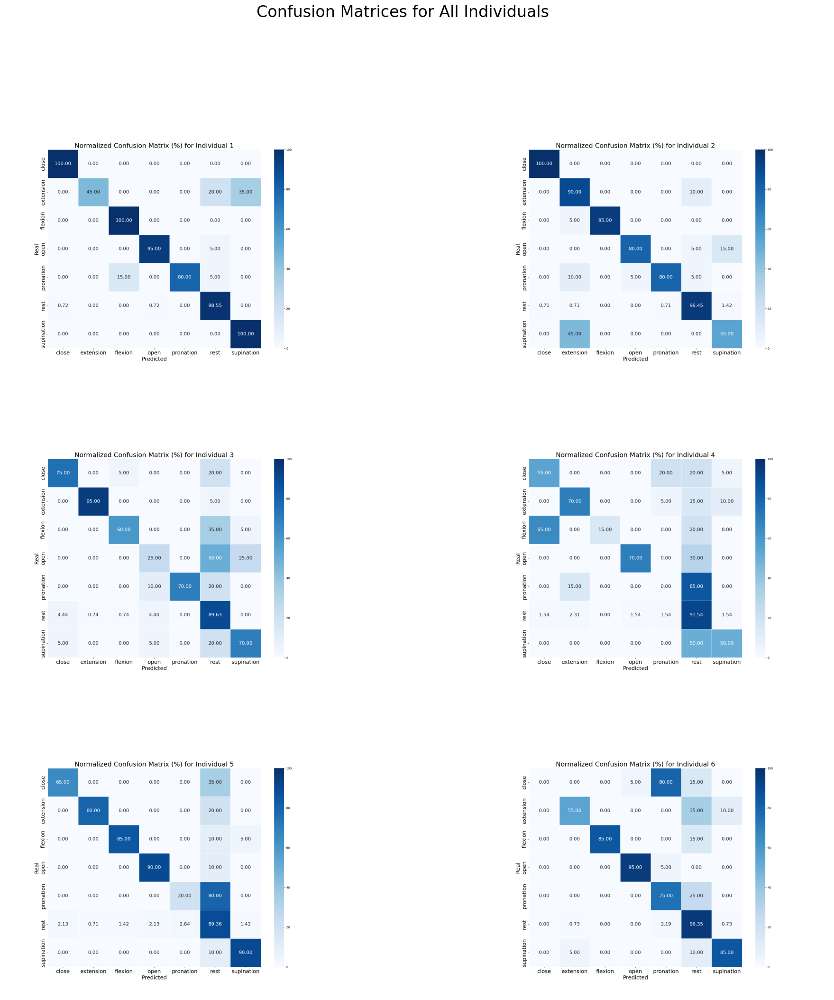

In [ ]:
# Plotting all confusion matrices in a single figure
fig_cm, axes_cm = plt.subplots(rows, 2, figsize=(24, 8 * rows))
axes_cm = np.array(axes_cm).flatten()

for i, fig in enumerate(all_cm_figs):
    fig.canvas.draw()
    img = np.array(fig.canvas.buffer_rgba())
    axes_cm[i].imshow(img)
    axes_cm[i].axis("off")

plt.suptitle("Confusion Matrices for All Individuals", fontsize=24)
plt.show()

`Matriz de confusão global (combinada para todos os indivíduos)`

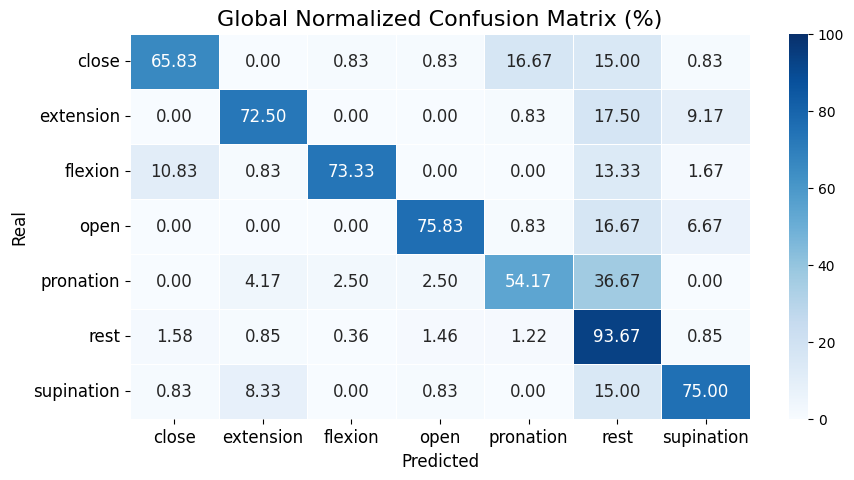

In [ ]:
# Normalize the global confusion matrix
global_cm_normalized = global_cm.astype('float') / global_cm.sum(axis=1, keepdims=True) * 100
global_cm_df = pd.DataFrame(global_cm_normalized, index=np.unique(y_test), columns=np.unique(y_test))

# Plot the combined confusion matrix
fig_cm, ax_cm = plt.subplots(figsize=(10, 5))
sns.heatmap(
    global_cm_df,
    annot=True,
    fmt=".2f",
    cmap="Blues",
    linewidths=0.5,
    vmin=0, vmax=100,
    ax=ax_cm,
    annot_kws={"size": 12}
)
ax_cm.set_title("Global Normalized Confusion Matrix (%)", fontsize=16)
ax_cm.set_xlabel("Predicted", fontsize=12)
ax_cm.set_ylabel("Real", fontsize=12)
ax_cm.tick_params(axis='both', which='major', labelsize=12)
plt.show()

Uma forma interessante de ver o resultado desse projeto é ver a classificação dos sinais funcionando em tempo real, como segue:

In [ ]:
import matplotlib as mpl

# Set a high limit for animation size
mpl.rcParams['animation.embed_limit'] = 100

In [ ]:
def animate_signals(test_df, predictions, window_size=250):
    """
    Animation showing muscle signals over time and detected movements.

    Args:
        test_df (pd.DataFrame): DataFrame containing the muscle signals.
        predictions (list): List containing the predicted movements.
        window_size (int): Size of the window used to extract features.
    """
    channels = test_df.columns
    num_channels = len(channels)

    fig, axes = plt.subplots(num_channels, 1, figsize=(12, 8), sharex=True)
    fig.suptitle("Real-Time Movement Classification", fontsize=16)

    lines = []
    for i, ax in enumerate(axes):
        ax.set_xlim(0, len(test_df))
        ax.set_ylim(test_df[channels[i]].min(), test_df[channels[i]].max())
        ax.set_title(f"{channels[i]}")
        ax.set_ylabel("Amplitude")
        ax.grid(True)
        line, = ax.plot([], [], label=channels[i], color="blue")
        lines.append(line)

    axes[-1].set_xlabel("Time (Samples)")

    state_text = axes[0].text(0.02, 0.85, "", transform=axes[0].transAxes, fontsize=12, color="red")

    def update(frame):
        end = (frame + 1) * window_size
        if end > len(test_df):
            end = len(test_df)

        for i, channel in enumerate(channels):
            lines[i].set_data(range(end), test_df[channel].iloc[:end])

        if frame < len(predictions):
            state_text.set_text(f"Movement detected: {predictions[frame]}")
        return lines + [state_text]

    ani = animation.FuncAnimation(
        fig, update, frames=len(predictions), interval=100, blit=False, repeat=False
    )

    ani_html = HTML(ani.to_jshtml())
    plt.close(fig)
    return ani_html

In [ ]:
# Running the animation for the test data of subject 6 (any)
test_df = pd.read_csv(f"{data_dir}/6/test.csv", delimiter=";")
animate_html = animate_signals(test_df, best_y_pred, 250)

display(animate_html)

## Conclusões e Discussões

### Comparação entre Modelos Individuais e Modelo Geral

#### Desempenho dos Modelos Individuais

Ao avaliar os modelos individuais, percebe-se que os resultados variam significativamente entre os indivíduos. Analisando os valores de *recall* (uma métrica que busca-se maximizar no cenário de controle de dispositivos robóticos, já que um falso negativo significa que um movimento real do usuário pode não ser reconhecido, impedindo o exoesqueleto de agir corretamente), os reports de classificação mostram que alguns indivíduos apresentaram *recall* maior que **80%** (indivíduo 5), enquanto outros tiveram um desempenho mais abaixo, em torno de **60%** (indivíduo 4). Isso sugere que a qualidade do sinal mioelétrico e as diferenças anatômicas na forma de execução dos movimentos de cada indivíduo impactam de alguma forma na performance do modelo.

As matrizes de confusão dos modelos individuais não sugerem um padrão claro de acerto/erro na classificação, porém é possível perceber que, com exceção ds indivíduos 1 e 4, a classificação dos movimentos de `fechamento de mão` e `extensão de cotovelo` se manteve relativamente boa pare todos os indivíduos. Além disso, nas matrizes dos indivíduos 3, 4, 5, e 6, é possível perceber uma frequente confusão dos modelos no que se diz respeito ao movimento `relaxado`, no sentido de que ele acabou classificando muitas janelas de sinais como relaxado quando na verdade já se estava executando um movimento. Uma possível explicação para isso é que não adotou-se o método de sobreposição de janelas na nossa metodologia, logo, períodos de tempo no início ou no final dos movimentos podem facilmente serem confundidos com o estado `relaxado`, já que nesses momentos a ativação muscular é diminuta.

#### Desempenho do Modelo Geral

Ao considerar o modelo geral, treinado com dados de todos os indivíduos e testado separadamente para cada um, os reports de classificação indicam que, surpreendentemente, o desempenho foi superior ao dos modelos individuais, tendo alguns indivíduos (como o 1) um *recall* maior que **88%** e outros dois com recall maior que **82%** (indivíduos 2 e 6). Esse resultado é inesperado, pois os sinais mioelétricos variam de pessoa para pessoa, e misturar dados de diferentes indivíduos para o treinamento poderia parecer uma abordagem inadequada. Uma possível explicação para essa vantagem é a extração de features. Ao utilizar apenas as características extraídas do sinal (e não o sinal bruto), conseguimos atenuar as variações individuais nos valores absolutos, capturando apenas informações de nível mais alto, como média e desvio padrão.

Acompanhando os reports de classificação, as matrizes de confusão do modelo geral apresentam menor incidência de erros em comparação com os modelos individuais, representado pela diagonal principal mais 'escura' para quase todos os indivíduos. Esse efeito pode ser explicado pelo maior volume de dados disponíveis no treinamento, reduzindo o risco de overfitting e aumentando a robustez na classificação. No entanto, ainda há confusões significativas em determinadas classes, principalmente no que diz respeito ao indivíduo 4.

O **indivíduo 4**, teve um desempenho nos testes significativamente inferior ao dos demais, tanto com o modelo individual quanto com o geral. Esse é o único indivíduo do sexo **feminino** que participou da coleta de dados, o que pode indicar que seus sinais mioelétricos possuem menor amplitude devido à uma possível menor massa muscular (Sartor et al., 2013), resultando em menor diferença na ativação dos músculos durante os movimentos, dificultando assim o aprendizado dos modelos. Além disso, é possível que sua inclusão tenha impactado negativamente o desempenho do modelo geral para os outros indivíduos, já que os padrões de sinal podem ser substancialmente diferentes.

#### Análise dos resultados combinados do modelo geral

Ao analisar o report de classificação global, percebe-se que o modelo geral mantém um equilíbrio entre _precision_, _recall_ e _f1-score_ para a maioria das classes, obtendo uma média em torno de **70%** em todas essas métricas.

A matriz de confusão global destaca que os movimentos com maior taxa de acerto (acima de **70%**) são: `extensão`, `flexão`, `abertura` e `supinação`. Não estamos considerando aqui o movimento `relaxado`, já que esse teve uma quantidade de amostras muito superior às demais classes no conjunto de dados, e não é a mais interessante de se analisar no nosso contexto.


### Limitações e Trabalhos Futuros

Apesar dos resultados promissores, algumas limitações devem ser destacadas:

- **Desequilíbrio de Classes**: A classe `relaxado` estava muito mais presente no conjunto de dados do que todas as outras, impactando a capacidade do modelo de aprender padrões para os outros movimentos.
- **Fatores Biológicos**: Diferenças anatômicas, como massa muscular e nível de fadiga, podem afetar a qualidade dos sinais, exigindo técnicas de normalização mais sofisticadas.

Para pesquisas futuras, sugere-se explorar:

- **Sobreposição de Janelas**: Investigar o efeito de diferentes níveis de sobreposição na segmentação dos sinais mioelétricos para otimizar a extração de features e melhorar a precisão da classificação.
- **Modelos Personalizados**: Estratégias como _fine-tuning_ ou aprendizado por transferência podem ser empregadas para adaptar o modelo a cada indivíduo.
- **Aprimoramento na Extração de Features**: Testar novos métodos de seleção e extração de características pode ajudar a melhorar a separação entre classes.
- **Uso de Redes Neurais Profundas**: Modelos mais avançados, como redes LSTM ou CNNs, podem ser investigados para capturar padrões temporais e espaciais dos sinais mioelétricos com maior precisão.
- **Inclusão de Novos Perfis de Usuários**: Testar o modelo com uma população mais diversa, incluindo diferentes faixas etárias e condições musculares, ajudaria a validar sua aplicabilidade em cenários reais.

Em resumo, os resultados obtidos sugerem que um modelo geral treinado com múltiplos indivíduos pode ser uma abordagem promissora para a classificação de movimentos mioelétricos. No entanto, adaptações individuais e técnicas mais avançadas podem ser necessárias para otimizar a precisão para todos os usuários.

## Referências

- AHKAMI, B.; AHMED, K.; THESLEFF, A.; HARGROVE, L.; ORTIZ-CATALAN, MAX. Electromyography-Based Control of Lower Limb Prostheses: A Systematic Review. IEEE Transactions on Medical Robotics and Bionics, [s. l.], v. 5, n. 3, p. 547–562, ago. 2023.

- BOGUE, R. Robots in healthcare. Industrial Robot: An International Journal, Okehampton, v. 38, n. 3, p. 218–223, jan. 2011.

- FLEMING, A.; STAFFORD, N.; HUANG, S.; HU, X.; FERRIS, D. P.; HUANG, H. Myoelectric Control of Robotic Lower Limb Prostheses: A Review of Electromyography Interfaces, Control Paradigms, Challenges and Future Directions. Journal of Neural Engineering, [s. l.], v. 18, n. 4, p. 1-22, ago. 2021.

- GILROY, Ae M. Atlas de Anatomia, 3a edição. Guanabara Koogan, 09/2017.

- Goodfellow, I., Bengio, Y., & Courville, A. (2016). Deep Learning. MIT Press. Disponível em: https://www.deeplearningbook.org.

- HAGBERG, K.; BRANEMARK, R.; GUNTERBERG, B.; RYDEVIC, B. Osseointegrated Trans-Femoral Amputation Prostheses: Prospective Results of General and Condition-Specific Quality of Life in 18 Patients at 2-Year Follow-Up. Prosthetics and Orthotics International, Goteborg, v. 32, n. 1, p. 29-41, mar. 2008.

- MCMANUS, L.; DE VITO, G.; LOWERY, M. M. Analysis and Biophysics of Surface EMG for Physiotherapists and Kinesiologists: Toward a Common Language With Rehabilitation Engineers. Frontiers in Neurology, [s. l.], v. 11, p. 1-25, out. 2020.

- NETTER, Frank H. Atlas de anatomia humana. 7ª ed. Rio de Janeiro: Elsevier, 2019, 602 p.

- NICORA, Giovanna et al. A Systematic Review of Machine Learning in Robotics-Assisted Rehabilitation. In Review. Disponível em: https://www.researchsquare.com/article/rs-4674885/v1. Acesso em: 10 fev. 2025. 3 set. 2024.

- Números do AVC. Disponível em: https://avc.org.br/numeros-do-avc/. Acesso em: 10 fev. 2025.

- PARKER, P.; ENGLEHART, K.; HUDGINS, B. Myoelectric Signal Processing for Control of Powered Limb Prostheses. Journal of Electromyography and Kinesiology, v. 16, n. 6, p. 541–548, dez. 2006.

- PEIXOTO, Alberto Monteiro et al. Prevalência de amputações de membros superiores e inferiores no estado de Alagoas atendidos pelo SUS entre 2008 e 2015. Fisioterapia e Pesquisa, v. 24, p. 378–384, dez. 2017.

- ROHEN, J. W.; YOKOCHI, C.; LÜTJEN-DRECOLL, E. Anatomia humana: atlas fotográfico de anatomia sistêmica e regional. 5. ed. São Paulo: Editora Manole Ltda, 2002, 486 p.

- Sartor, C. D., Pinho, A. S., Silva, B. C., & Sacco, I. C. (2013). Effects of gender and fatigue on lower limb kinematics during recreational running. Brazilian Journal of Physical Therapy, 17(1), 74-80.

- VALLE, G.; SALIGI, A.; FOGLE, E.; CIMOLATO, A.; PETRINI, F. M.; RASPOPOVIC, S. Mechanisms of neuro-robotic prosthesis operation in leg amputees. Science Advances, [s. l.], v. 7, n. 17, p. 1-13, abr. 2021.

- WILLIAMS, M. R.; D’ANDREA, S.; HERR, H. M. Impact on gait biomechanics of using an active variable impedance prosthetic knee. Journal of NeuroEngineering and Rehabilitation, [s. l.], v. 13, n. 1, p. 1-11, jun. 2016.